In [ ]:
!pip install spacy==3.7.6
!pip install nltk==3.9.1
!pip install beautifulsoup4
!python -m spacy download en_core_web_sm
!pip install textblob==0.18.0.post0
!pip install googletrans==4.0.0rc1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 6.1 MB/s eta 0:00:00
Reason for being yanked: Incorrect compatibility for transformer models
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.7/31.7 MB 61.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.0/183.0 kB 19.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 865.0/865.0 kB 44.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 95.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 117.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 98.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 59.9 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
  Attempting uninstall: blis
    Found existing installation: blis 1.3.0
    Uninstalling blis-1.3.0:
      Successfully uninstalled blis-1.3.0
  

ERROR: Operation cancelled by user
^C


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import re
from wordcloud import WordCloud

In [2]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, LSTM, Conv1D, MaxPooling1D
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score


In [10]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [11]:
import pandas as pd
fake = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/datasets/Fake.csv")

In [12]:
fake

,title,text,subject,date
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017"
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017"
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017"
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017"
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017"
...,...,...,...,...
23476,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,"January 16, 2016"
23477,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,"January 16, 2016"
23478,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,"January 15, 2016"
23479,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,"January 14, 2016"


In [13]:
fake.columns

Index(['title', 'text', 'subject', 'date'], dtype='object')

In [14]:
fake['subject'].value_counts()

,count
subject,
News,9050
politics,6841
left-news,4459
Government News,1570
US_News,783
Middle-east,778


<Axes: xlabel='subject', ylabel='count'>

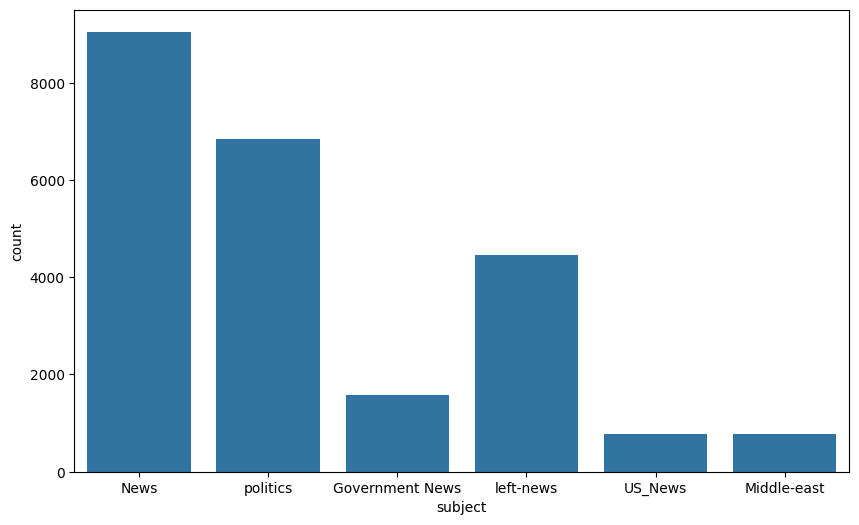

In [15]:
plt.figure(figsize=(10,6)) #Seaborn draws the plot inside that 10×6 inch canvas.
sns.countplot(x='subject',data=fake)

In [16]:
text=''.join(fake['text'].tolist())

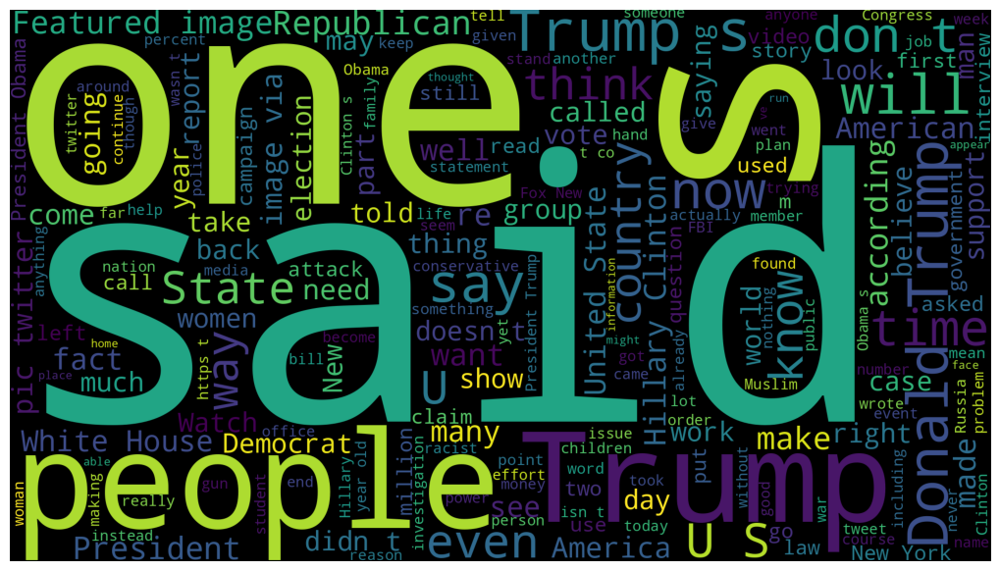

In [17]:
wordcloud=WordCloud(width=1920,height=1080).generate(text)

plt.figure(figsize=(10,10))
plt.imshow(wordcloud)
plt.axis('off') # to hide x axis and y axis date
plt.tight_layout(pad=0)
plt.show() # to hide <matplotlib.image.AxesImage at 0x7bc052126750>

In [18]:
# from wordcloud import WordCloud
# import matplotlib.pyplot as plt

# text1 = "Machine learning is fun when you learn machine learning with Python"
# wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text1)


# plt.imshow(wordcloud)


In [19]:
real=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/datasets/True.csv")

In [20]:

text1=''.join(fake['text'].tolist())

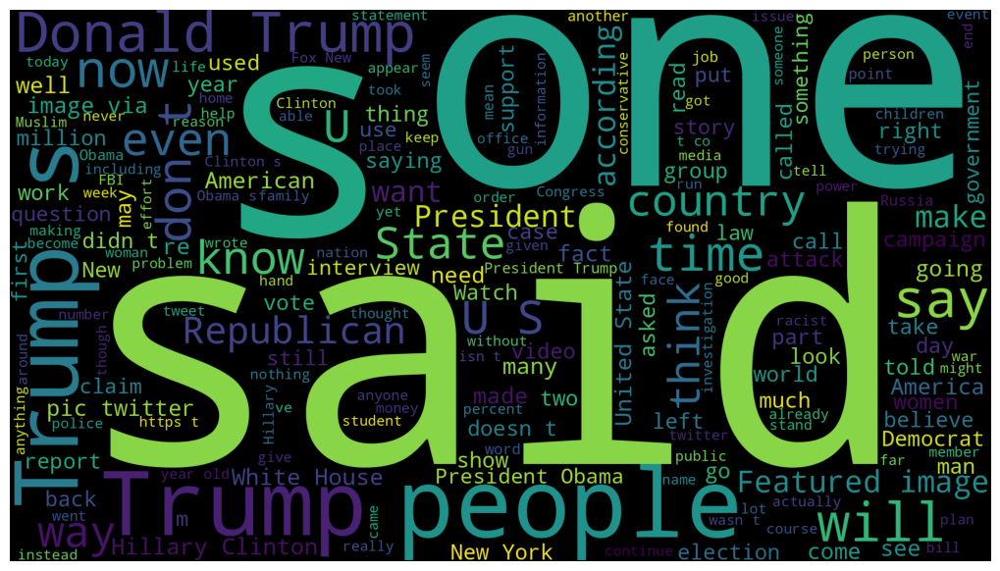

In [21]:
wordcloud=WordCloud(width=1920,height=1080).generate(text1)

plt.figure(figsize=(10,10))
plt.imshow(wordcloud)
plt.axis('off') # to hide x axis and y axis date
plt.tight_layout(pad=0)
plt.show() # to hide <matplotlib.image.AxesImage at 0x7bc052126750>

In [22]:
#cleaning data

In [23]:
real.sample(5) # gives random 5 rows

,title,text,subject,date
12936,Checks for free: a Mexican plan to combat poverty,MEXICO CITY (Reuters) - An opposition alliance...,worldnews,"December 6, 2017"
18997,EU's Juncker hails Macron speech as 'very Euro...,BRUSSELS (Reuters) - European Commission Presi...,worldnews,"September 26, 2017"
3597,Trump retains Marc Kasowitz as private attorne...,(This May 23 story corrects name to Fox Busin...,politicsNews,"May 23, 2017"
19029,China's Xi says will support Interpol raising ...,BEIJING (Reuters) - China will support Interpo...,worldnews,"September 26, 2017"
8263,Duterte regrets Obama comments came across as ...,VIENTIANE (Reuters) - The Philippines said on ...,politicsNews,"September 6, 2016"


In [24]:
unknown_publishers=[]
for index,rows in enumerate(real.text.values):

  try:
    record=rows.split('-',maxsplit=1)
    record[1]

    assert(len(record[0])<120) #Checks that the extracted publisher name isn’t absurdly long.is it is then thrws assertion error
  except:
    unknown_publishers.append(index)

In [25]:
len(unknown_publishers)

222

In [26]:
real.iloc[unknown_publishers].text

,text
7,The following statements were posted to the ve...
8,The following statements were posted to the ve...
12,The following statements were posted to the ve...
13,The following statements were posted to the ve...
14,"(In Dec. 25 story, in second paragraph, corre..."
...,...
20135,(Story corrects to million from billion in pa...
20500,"(This Sept 8 story corrects headline, clarifi..."
20667,"(Story refiles to add dropped word not , in ..."
21246,(Story corrects third paragraph to show Mosul...


In [27]:

real.iloc[8970]

,8970
title,Graphic: Supreme Court roundup
text,
subject,politicsNews
date,"June 16, 2016"


In [28]:
real.drop(8970,axis=0)

,title,text,subject,date
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017"
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017"
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017"
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017"
...,...,...,...,...
21412,'Fully committed' NATO backs new U.S. approach...,BRUSSELS (Reuters) - NATO allies on Tuesday we...,worldnews,"August 22, 2017"
21413,LexisNexis withdrew two products from Chinese ...,"LONDON (Reuters) - LexisNexis, a provider of l...",worldnews,"August 22, 2017"
21414,Minsk cultural hub becomes haven from authorities,MINSK (Reuters) - In the shadow of disused Sov...,worldnews,"August 22, 2017"
21415,Vatican upbeat on possibility of Pope Francis ...,MOSCOW (Reuters) - Vatican Secretary of State ...,worldnews,"August 22, 2017"


In [29]:
publisher=[]
tmp_text=[]
for index,row in enumerate(real.text.values):
  if index in unknown_publishers:
    tmp_text.append(row)
    publisher.append('Unknown')
  else:
    record=row.split('-',maxsplit=1)
    publisher.append(record[0].strip())
    tmp_text.append(record[1].strip())




In [30]:
real['publisher']=publisher
real['text']=tmp_text

In [31]:

real

,title,text,subject,date,publisher
0,"As U.S. budget fight looms, Republicans flip t...",The head of a conservative Republican faction ...,politicsNews,"December 31, 2017",WASHINGTON (Reuters)
1,U.S. military to accept transgender recruits o...,Transgender people will be allowed for the fir...,politicsNews,"December 29, 2017",WASHINGTON (Reuters)
2,Senior U.S. Republican senator: 'Let Mr. Muell...,The special counsel investigation of links bet...,politicsNews,"December 31, 2017",WASHINGTON (Reuters)
3,FBI Russia probe helped by Australian diplomat...,Trump campaign adviser George Papadopoulos tol...,politicsNews,"December 30, 2017",WASHINGTON (Reuters)
4,Trump wants Postal Service to charge 'much mor...,President Donald Trump called on the U.S. Post...,politicsNews,"December 29, 2017",SEATTLE/WASHINGTON (Reuters)
...,...,...,...,...,...
21412,'Fully committed' NATO backs new U.S. approach...,NATO allies on Tuesday welcomed President Dona...,worldnews,"August 22, 2017",BRUSSELS (Reuters)
21413,LexisNexis withdrew two products from Chinese ...,"LexisNexis, a provider of legal, regulatory an...",worldnews,"August 22, 2017",LONDON (Reuters)
21414,Minsk cultural hub becomes haven from authorities,In the shadow of disused Soviet-era factories ...,worldnews,"August 22, 2017",MINSK (Reuters)
21415,Vatican upbeat on possibility of Pope Francis ...,Vatican Secretary of State Cardinal Pietro Par...,worldnews,"August 22, 2017",MOSCOW (Reuters)


In [32]:
empty_fake_index =[index for index, text in enumerate(fake.text.tolist())if str(text).strip() == ""]
empty_fake_index


[10923,
 11041,
 11190,
 11225,
 11236,
 11241,
 11247,
 11249,
 11267,
 11268,
 11283,
 11284,
 11285,
 11289,
 11290,
 11292,
 11295,
 11296,
 11301,
 11303,
 11304,
 11305,
 11309,
 11314,
 11317,
 11319,
 11322,
 11330,
 11334,
 11335,
 11340,
 11343,
 11348,
 11351,
 11352,
 11357,
 11371,
 11373,
 11374,
 11382,
 11397,
 11402,
 11403,
 11409,
 11410,
 11412,
 11415,
 11419,
 11421,
 11427,
 11431,
 11432,
 11440,
 11448,
 11450,
 11453,
 11462,
 11464,
 11465,
 11472,
 11473,
 11475,
 11478,
 11489,
 11491,
 11493,
 11494,
 11501,
 11505,
 11507,
 11520,
 11531,
 11532,
 11533,
 11538,
 11542,
 11547,
 11549,
 11551,
 11559,
 11563,
 11581,
 11585,
 11589,
 11590,
 11614,
 11624,
 11625,
 11627,
 11631,
 11636,
 11637,
 11643,
 11650,
 11658,
 11661,
 11672,
 11679,
 11681,
 11684,
 11686,
 11688,
 11692,
 11708,
 11718,
 11729,
 11739,
 11753,
 11765,
 11768,
 11777,
 11782,
 11786,
 11788,
 11792,
 11793,
 11803,
 11806,
 11813,
 11821,
 11831,
 11832,
 11841,
 11844,
 11848,


In [33]:
fake.iloc[empty_fake_index]

,title,text,subject,date
10923,TAKE OUR POLL: Who Do You Think President Trum...,,politics,"May 10, 2017"
11041,Joe Scarborough BERATES Mika Brzezinski Over “...,,politics,"Apr 26, 2017"
11190,WATCH TUCKER CARLSON Scorch Sanctuary City May...,,politics,"Apr 6, 2017"
11225,MAYOR OF SANCTUARY CITY: Trump Trying To Make ...,,politics,"Apr 2, 2017"
11236,SHOCKER: Public School Turns Computer Lab Into...,,politics,"Apr 1, 2017"
...,...,...,...,...
21816,BALTIMORE BURNS: MARYLAND GOVERNOR BRINGS IN N...,,left-news,"Apr 27, 2015"
21826,FULL VIDEO: THE BLOCKBUSTER INVESTIGATION INTO...,,left-news,"Apr 25, 2015"
21827,(VIDEO) HILLARY CLINTON: RELIGIOUS BELIEFS MUS...,,left-news,"Apr 25, 2015"
21857,(VIDEO)ICE PROTECTING OBAMA: WON’T RELEASE NAM...,,left-news,"Apr 14, 2015"


In [34]:
# merge title and text since text is present in title

In [35]:
real['text']=real['title']+" "+real['text']
fake['text']=fake['title']+" "+fake['text']

In [36]:
real['text']=real['text'].apply(lambda x: str(x).lower())
fake['text']=fake['text'].apply(lambda x: str(x).lower())

In [37]:
#Preprocessing

In [38]:
real['class']=1
fake['class']=0

In [39]:
real.columns

Index(['title', 'text', 'subject', 'date', 'publisher', 'class'], dtype='object')

In [40]:
real=real[['text','class']]
fake=fake[['text','class']]

In [41]:
real

,text,class
0,"as u.s. budget fight looms, republicans flip t...",1
1,u.s. military to accept transgender recruits o...,1
2,senior u.s. republican senator: 'let mr. muell...,1
3,fbi russia probe helped by australian diplomat...,1
4,trump wants postal service to charge 'much mor...,1
...,...,...
21412,'fully committed' nato backs new u.s. approach...,1
21413,lexisnexis withdrew two products from chinese ...,1
21414,minsk cultural hub becomes haven from authorit...,1
21415,vatican upbeat on possibility of pope francis ...,1


In [42]:
data = pd.concat([real, fake], ignore_index=True)
data


,text,class
0,"as u.s. budget fight looms, republicans flip t...",1
1,u.s. military to accept transgender recruits o...,1
2,senior u.s. republican senator: 'let mr. muell...,1
3,fbi russia probe helped by australian diplomat...,1
4,trump wants postal service to charge 'much mor...,1
...,...,...
44893,mcpain: john mccain furious that iran treated ...,0
44894,justice? yahoo settles e-mail privacy class-ac...,0
44895,sunnistan: us and allied ‘safe zone’ plan to t...,0
44896,how to blow $700 million: al jazeera america f...,0


In [43]:
def remove_special_chars(x):
    pattern = r'[^\w\s]'
    return re.sub(pattern, '', x)



In [44]:
#Vectorization

In [45]:
data['text'] = data['text'].apply(lambda x: remove_special_chars(x))


In [46]:
!pip install gensim


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.9/27.9 MB 71.5 MB/s eta 0:00:00


In [47]:
import gensim

In [48]:
y=data['class'].values

In [49]:
y

array([1, 1, 1, ..., 0, 0, 0])

In [50]:
X=[d.split() for d in data['text'].tolist()]

In [51]:
X

[['as',
  'us',
  'budget',
  'fight',
  'looms',
  'republicans',
  'flip',
  'their',
  'fiscal',
  'script',
  'the',
  'head',
  'of',
  'a',
  'conservative',
  'republican',
  'faction',
  'in',
  'the',
  'us',
  'congress',
  'who',
  'voted',
  'this',
  'month',
  'for',
  'a',
  'huge',
  'expansion',
  'of',
  'the',
  'national',
  'debt',
  'to',
  'pay',
  'for',
  'tax',
  'cuts',
  'called',
  'himself',
  'a',
  'fiscal',
  'conservative',
  'on',
  'sunday',
  'and',
  'urged',
  'budget',
  'restraint',
  'in',
  '2018',
  'in',
  'keeping',
  'with',
  'a',
  'sharp',
  'pivot',
  'under',
  'way',
  'among',
  'republicans',
  'us',
  'representative',
  'mark',
  'meadows',
  'speaking',
  'on',
  'cbs',
  'face',
  'the',
  'nation',
  'drew',
  'a',
  'hard',
  'line',
  'on',
  'federal',
  'spending',
  'which',
  'lawmakers',
  'are',
  'bracing',
  'to',
  'do',
  'battle',
  'over',
  'in',
  'january',
  'when',
  'they',
  'return',
  'from',
  'the',
  

In [52]:
X[0]

['as',
 'us',
 'budget',
 'fight',
 'looms',
 'republicans',
 'flip',
 'their',
 'fiscal',
 'script',
 'the',
 'head',
 'of',
 'a',
 'conservative',
 'republican',
 'faction',
 'in',
 'the',
 'us',
 'congress',
 'who',
 'voted',
 'this',
 'month',
 'for',
 'a',
 'huge',
 'expansion',
 'of',
 'the',
 'national',
 'debt',
 'to',
 'pay',
 'for',
 'tax',
 'cuts',
 'called',
 'himself',
 'a',
 'fiscal',
 'conservative',
 'on',
 'sunday',
 'and',
 'urged',
 'budget',
 'restraint',
 'in',
 '2018',
 'in',
 'keeping',
 'with',
 'a',
 'sharp',
 'pivot',
 'under',
 'way',
 'among',
 'republicans',
 'us',
 'representative',
 'mark',
 'meadows',
 'speaking',
 'on',
 'cbs',
 'face',
 'the',
 'nation',
 'drew',
 'a',
 'hard',
 'line',
 'on',
 'federal',
 'spending',
 'which',
 'lawmakers',
 'are',
 'bracing',
 'to',
 'do',
 'battle',
 'over',
 'in',
 'january',
 'when',
 'they',
 'return',
 'from',
 'the',
 'holidays',
 'on',
 'wednesday',
 'lawmakers',
 'will',
 'begin',
 'trying',
 'to',
 'pass',
 

In [53]:
DIM=100
w2v_model=gensim.models.Word2Vec(sentences=X,vector_size=100,window=12,min_count=1,workers=4 )


In [54]:

len(w2v_model.wv.key_to_index)   #   total unique words



230893

In [55]:
w2v_model.wv.key_to_index

{'the': 0,
 'to': 1,
 'of': 2,
 'a': 3,
 'and': 4,
 'in': 5,
 'that': 6,
 'on': 7,
 'for': 8,
 's': 9,
 'is': 10,
 'he': 11,
 'said': 12,
 'trump': 13,
 'it': 14,
 'with': 15,
 'was': 16,
 'as': 17,
 'his': 18,
 'by': 19,
 'has': 20,
 'be': 21,
 'have': 22,
 'not': 23,
 'from': 24,
 'this': 25,
 'at': 26,
 'are': 27,
 'who': 28,
 'us': 29,
 'an': 30,
 'they': 31,
 'i': 32,
 'but': 33,
 'we': 34,
 'would': 35,
 'president': 36,
 'about': 37,
 'will': 38,
 'their': 39,
 'had': 40,
 'you': 41,
 't': 42,
 'been': 43,
 'were': 44,
 'people': 45,
 'more': 46,
 'or': 47,
 'after': 48,
 'which': 49,
 'she': 50,
 'her': 51,
 'one': 52,
 'if': 53,
 'its': 54,
 'out': 55,
 'all': 56,
 'what': 57,
 'state': 58,
 'when': 59,
 'new': 60,
 'also': 61,
 'up': 62,
 'there': 63,
 'over': 64,
 'no': 65,
 'house': 66,
 'donald': 67,
 'our': 68,
 'states': 69,
 'clinton': 70,
 'obama': 71,
 'government': 72,
 'can': 73,
 'just': 74,
 'him': 75,
 'so': 76,
 'than': 77,
 'republican': 78,
 'other': 79,
 'som

In [56]:
w2v_model.wv['love']


array([ 2.6584122 ,  1.477016  ,  1.5434855 , -3.5277178 ,  2.5204241 ,
       -1.1909256 , -1.1479378 ,  3.4034321 , -1.4109335 ,  3.2977536 ,
        0.76207095, -3.7124157 , -2.6273215 , -2.322321  , -2.8008578 ,
       -1.0738562 ,  0.08425596,  1.0524583 , -0.3957981 , -0.31849387,
        0.7041931 , -0.7425885 , -1.8450656 ,  3.7537448 , -1.007704  ,
        6.2888694 , -0.42572793, -1.9570072 ,  1.8726202 , -1.0346646 ,
       -0.8434872 ,  0.02849955, -1.3852215 ,  3.168291  , -1.5682875 ,
        2.663066  ,  0.12120041,  0.25666192,  1.1258808 , -2.0618331 ,
        0.9883139 , -1.241507  , -4.117156  , -0.5859861 , -4.578443  ,
       -0.43097425,  2.817826  , -2.735757  , -0.9468728 , -0.16893235,
       -0.56455284, -0.94363916,  2.1763194 , -3.1324668 ,  0.05884127,
       -0.7780075 , -1.0801156 , -4.097924  , -4.6708765 , -0.9404237 ,
       -1.1437058 , -1.6688863 , -0.97327393, -3.397384  ,  0.95092773,
        0.37984797,  0.3320778 ,  2.8433628 , -0.7626057 ,  2.61

In [57]:
w2v_model.wv.most_similar('love')#those floating numbers are similarity scores like 0.9 = 90 percent similarity

[('thank', 0.696541428565979),
 ('applaud', 0.6926444172859192),
 ('loving', 0.6799787282943726),
 ('appreciate', 0.6679715514183044),
 ('admire', 0.6659920811653137),
 ('beautiful', 0.6506912708282471),
 ('wish', 0.6469912528991699),
 ('wonderful', 0.6429275274276733),
 ('bless', 0.6275455951690674),
 ('suppose', 0.6152478456497192)]

In [ ]:
# to refeed this vector again to ml model and get quite accurate vector

In [58]:
tokenizer=Tokenizer()
tokenizer.fit_on_texts(X)

In [59]:
X=tokenizer.texts_to_sequences(X)

In [60]:
X

[[18,
  30,
  473,
  481,
  10669,
  133,
  8091,
  40,
  1375,
  5172,
  1,
  419,
  3,
  4,
  301,
  79,
  6312,
  6,
  1,
  30,
  189,
  29,
  774,
  26,
  279,
  9,
  4,
  1107,
  2958,
  3,
  1,
  124,
  953,
  2,
  448,
  9,
  184,
  1193,
  173,
  394,
  4,
  1375,
  301,
  8,
  342,
  5,
  1109,
  473,
  7805,
  6,
  1188,
  6,
  1764,
  16,
  4,
  3407,
  7898,
  141,
  164,
  320,
  133,
  30,
  798,
  921,
  7806,
  675,
  8,
  2010,
  476,
  1,
  383,
  1761,
  4,
  559,
  589,
  8,
  168,
  691,
  50,
  408,
  28,
  17341,
  2,
  89,
  1352,
  65,
  6,
  410,
  60,
  32,
  776,
  25,
  1,
  8092,
  8,
  203,
  408,
  39,
  1438,
  350,
  2,
  929,
  4,
  168,
  473,
  6,
  4,
  481,
  304,
  2,
  22,
  1957,
  2,
  80,
  426,
  170,
  18,
  312,
  208,
  107,
  18,
  1,
  515,
  570,
  96,
  1779,
  1503,
  6,
  50,
  133,
  39,
  1072,
  2,
  377,
  349,
  3,
  189,
  37,
  68,
  14,
  5,
  19,
  133,
  182,
  4,
  379,
  473,
  959,
  6,
  169,
  691,
  110,
  196,
  62,

In [61]:
#tokenizer.word_index

In [62]:
# [len(x) for x in X]

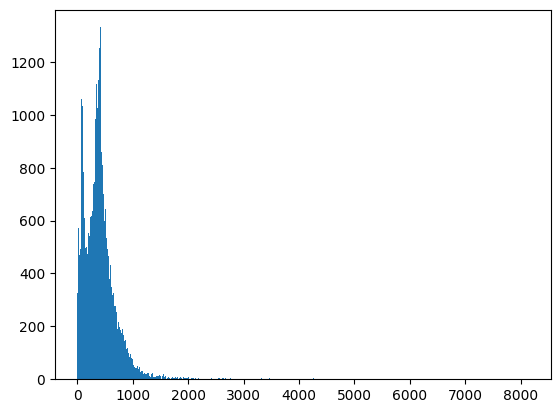

In [63]:
plt.hist([len(x) for x in X],bins=700)
plt.show()

In [64]:
nos=np.array([len(x) for x in X])
len(nos[nos>1000])

1587

In [65]:
maxlen = 1000
X = pad_sequences(X, maxlen=maxlen) # to make total length 1000

In [66]:
vocab_size=len(tokenizer.word_index)+1#The +1 is important because Keras reserves index 0 for padding.
vocab=tokenizer.word_index

In [67]:
def get_weight_matrix(model):
  weight_matrix=np.zeros((vocab_size,DIM))
  for word,i in vocab.items():
    weight_matrix[i]=model.wv[word]
  return weight_matrix


In [70]:
embedding_vectors=get_weight_matrix(w2v_model)

In [71]:
embedding_vectors.shape

(230894, 100)

In [72]:

model = Sequential()
model.add(Embedding(input_dim=vocab_size, output_dim=DIM, weights=[embedding_vectors],input_shape=(maxlen,) ,trainable=False))
# LSTM layer
model.add(LSTM(units=128))  # 128 memory units

# Output layer (binary classification example)
model.add(Dense(1, activation='sigmoid'))
model.compile(
    optimizer='adam',
    loss='binary_crossentropy',  # keyword argument is required
    metrics=['accuracy']         # 'acc' also works but 'accuracy' is more standard
)


/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/embedding.py:100: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [73]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding (Embedding)           │ (None, 1000, 100)      │    23,089,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, 128)            │       117,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,206,777 (88.53 MB)

 Trainable params: 117,377 (458.50 KB)

 Non-trainable params: 23,089,400 (88.08 MB)

In [74]:
X_train,X_test,y_train,y_test=train_test_split(X,y)

In [73]:
model.fit(X_train,y_train,validation_split=0.3,epochs=6)

In [ ]:
y_pred=(model.predict(X_test)>=0.3).astype(int)

351/351 ━━━━━━━━━━━━━━━━━━━━ 4s 13ms/step


In [ ]:
accuracy_score(y_test,y_pred)

0.9895768374164811

In [ ]:
# Save entire model (architecture + weights + optimizer state)
model.save('my_lstm_model.h5')  # or .keras in TF 2.11+


In [ ]:
from google.colab import files
files.download('my_lstm_model.h5')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [75]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score


In [76]:
y_pred = model.predict(X_test)
y_pred_classes = (y_pred > 0.5).astype(int)
print(classification_report(y_test, y_pred_classes))


351/351 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step
              precision    recall  f1-score   support

           0       0.33      0.26      0.29      5856
           1       0.34      0.41      0.37      5369

    accuracy                           0.33     11225
   macro avg       0.33      0.33      0.33     11225
weighted avg       0.33      0.33      0.33     11225



In [ ]:
import pickle

# assuming your tokenizer variable is named "tokenizer"
with open("tokenizer.pkl", "wb") as f:
    pickle.dump(tokenizer, f)


In [ ]:
from google.colab import files
files.download("tokenizer.pkl")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>